In [1]:
import folium
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

from matplotlib.ticker import FuncFormatter

df = pd.read_csv('eda_clean.csv')

In [2]:
# create map using folium with coordinates of Seattle city center
city_center = [47.6050242, -122.3343709]
m = folium.Map(location=city_center, control_scale=True, zoomstart=13)

median_price = df['price'].median()

# adding circles at house locations with color depending on house price
for _, row in df.iterrows():
    color = 'blue' if row['price'] >= median_price else 'red'

    # add circle
    folium.CircleMarker(
        location=[row['lat'], row['long']],
        radius=2,
        popup=f"Price: $ {row['price']:,}\nDistance Center: {round(row['dist_center'], 2)}",
        color=color,
        stroke=False,
        fill=True,
        fill_opacity=0.3
    ).add_to(m)

# add circle for median distance of below median priced houses
folium.Circle(
    location=city_center,
    radius=19463,
    popup='Below median price: 19.5 km',
    color='#FB5454',
    fill=False
).add_to(m)

# add circle for median distance of above median priced houses
folium.Circle(
    location=city_center,
    radius=14003,
    popup='Above median price: 14 km',
    color='#463FFF',
    fill=False
).add_to(m)

# add circle for city center
folium.CircleMarker(
    location=city_center,
    radius=15,
    popup='City Center',
    color='black',
    fill=True,
    fill_opacity=0.6
).add_to(m)

# showing map
m

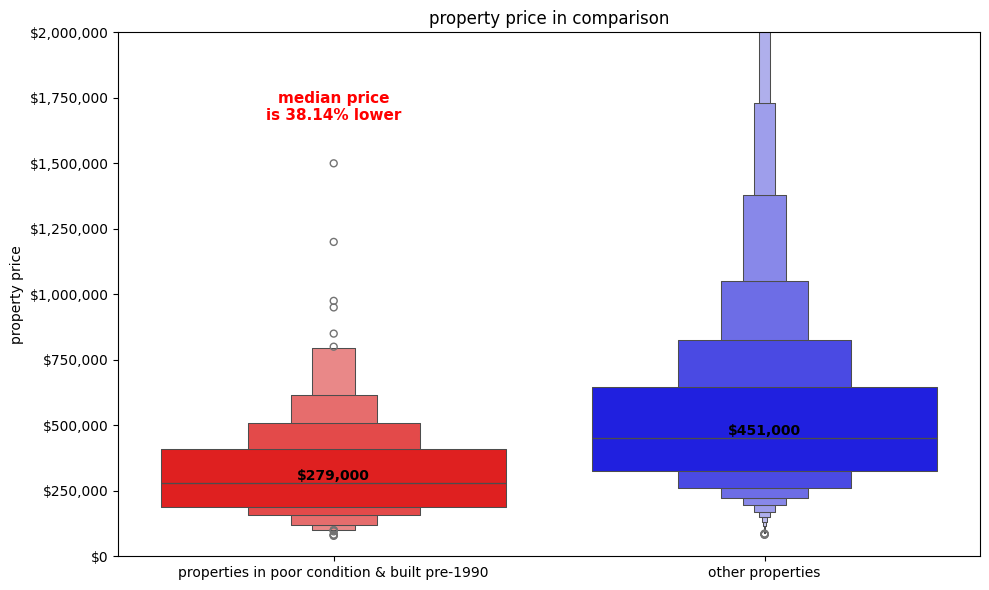

In [3]:
# filter for houses with certain conditions
old_poor_condition_houses = df[(df['condition'] < 3) & (df['yr_built'] < 1990)]
other_houses = df[(df['condition'] >= 3) | (df['yr_built'] >= 1990)]

# calculate medians of prices and ratio
old_poor_median = old_poor_condition_houses['price'].median()
other_median = other_houses['price'].median()
percentage = (1 - (old_poor_median / other_median)) * 100

# create combined dataframe for plotting
df_plot = pd.concat([
    old_poor_condition_houses.assign(group='properties in poor condition & built pre-1990'),
    other_houses.assign(group='other properties')
])

plt.figure(figsize=(10,6))

# create boxenplot from combined dataframe
ax = sns.boxenplot(
    data=df_plot,
    x='group', y='price',
    palette=['red', 'blue'],
    hue='group',
    legend=False
)

# format y-axis to represent values as decimal numbers with commas in dollars instead of scientific notation
ax.yaxis.set_major_formatter(FuncFormatter(lambda y, _: f'${y:,.0f}'))

# add median values as text to plots
plt.text(
    x=0, y=old_poor_median, 
    s=f'${old_poor_median:,.0f}', 
    color='black', ha='center', va='bottom', fontweight='bold'
)

plt.text(
    x=1, y=other_median, 
    s=f'${other_median:,.0f}', 
    color='black', ha='center', va='bottom', fontweight='bold'
)

# add percentage as text
ymax = ax.get_ylim()[1]
plt.text(
    x=0, y=ymax * 0.22,
    s=f'median price\nis {percentage:.2f}% lower',
    color='red', ha='center', va='top', fontsize=11, fontweight='bold'
)

# limit y to 2,000,000$ to focus on important part of data
plt.ylim(0, 2000000)

# labels
plt.xlabel('')
plt.ylabel('property price')
plt.title('property price in comparison')
plt.tight_layout()

# save image as png with transparent background for presentation
plt.savefig('boxenplot_old_poor_condition.png', transparent=True)

plt.show()

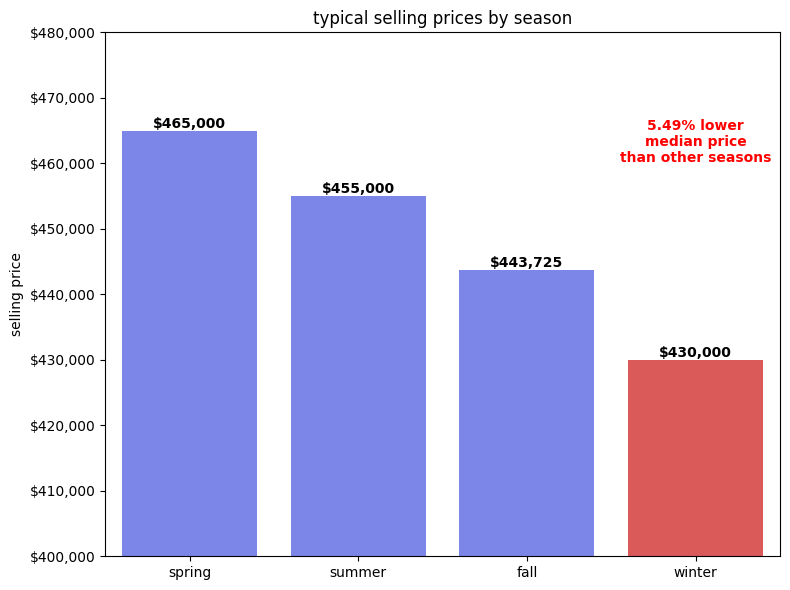

In [4]:
# calculate median price per season
season_medians = df.groupby('season')['price'].median().reset_index()

# calculate percentage between median price in winter and median price in other seasons
winter_median = season_medians.loc[season_medians['season'] == 'winter', 'price'].median()
other_median = season_medians.loc[season_medians['season'] != 'winter', 'price'].median()
percentage = (1 - winter_median / other_median) * 100

# define colors for plot
colors = ['#EF4444' if season == 'winter' else '#6977FA' for season in ['spring', 'summer', 'fall', 'winter']]

plt.figure(figsize=(8,6))

# create barplot from season_medians dataframe
ax = sns.barplot(
    data=season_medians,
    x='season', y='price',
    order=['spring', 'summer', 'fall', 'winter'],
    palette=colors,
    hue='season',
    legend=False
)

# format y-axis to represent values as decimal numbers with commas in dollars instead of scientific notation
ax.yaxis.set_major_formatter(FuncFormatter(lambda y, _: f'${y:,.0f}'))

# add medians as text to plot right above respective bar
for container in ax.containers:
    for bar in container:
        height = bar.get_height()
        plt.text(
            x=bar.get_x() + bar.get_width()/2, y=height,
            s=f'${height:,.0f}',
            ha='center', va='bottom', fontweight='bold', color='black'
        )

# add percentage as text
winter_index = season_medians.index[season_medians['season'] == 'winter'][0]
plt.text(
    x=winter_index, y=winter_median * 1.069,
    s=f'{percentage:.2f}% lower\nmedian price\nthan other seasons',
    ha='center', va='bottom', fontsize=10, fontweight='bold', color='red'
)

# limit y-axis to 400,000 to 480,000 to focus on important part of data
plt.ylim(400000, 480000)

# labels
plt.xlabel('')
plt.ylabel('selling price')
plt.title('typical selling prices by season')
plt.tight_layout()

# save image as png with transparent background for presentation
plt.savefig('barplot_median_season_price.png', transparent=True)

plt.show()